In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 13371
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  13371


In [2]:
# set up the directories
from pathgen.utils.seeds import set_seed
from pathgen.utils.paths import project_root

experiment_name = "paper"
experiment_root = project_root() / "experiments" / experiment_name

train_patches_dir = experiment_root / 'patches' / 'train' / 'normal'

In [3]:
# Number of workers for dataloader
workers = 16

# Batch size during training
batch_size = 256

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 400

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = torch.cuda.device_count()

In [4]:
from PIL import Image
from torch.utils.data import Dataset
from pathlib import Path
from typing import Any, Callable, cast, Dict, List, Optional, Tuple

# pil_loader taken from torchvision.datasets.folder source code
def pil_loader(path: str) -> Image.Image:
    # open path as file to avoid ResourceWarning (https://github.com/python-pillow/Pillow/issues/835)
    with open(path, 'rb') as f:
        img = Image.open(f)
        return img.convert('RGB')

# custom image loader that will just read all the images in one folder and ignore the label
class UnlabelledImageFolder(Dataset):
    def __init__(self, root_dir: Path, transform: Optional[Callable] = None):
        self.paths = list(root_dir.glob("*.png"))
        self.root_dir = root_dir
        self.transform = transform
    
    def __len__(self) -> int:
        return len(self.paths)
    
    def __getitem__(self, idx: int) -> Tuple[Any, Any]:
        path = self.paths[idx]
        image = pil_loader(path)
        if self.transform:
            image = self.transform(image)
        target = 0  # the target is always 0
        return image, target

        


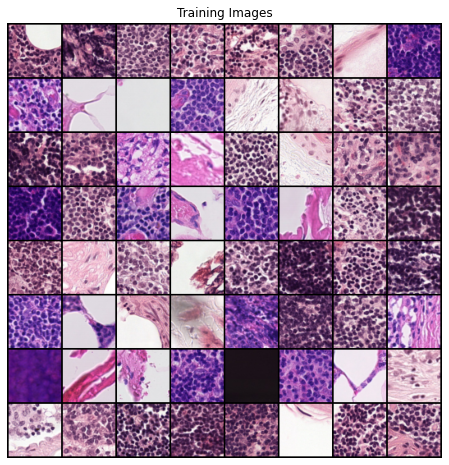

In [5]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = UnlabelledImageFolder(train_patches_dir, transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [6]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [7]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2

In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

DataParallel(
  (module): Discriminator(
    (main): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    

In [11]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [12]:
%%time

def save_model(name, model, epoch, optim, loss):
    filename = name + str(epoch) + '.pt'
    save_dir = experiment_root / 'gan_models'
    save_dir.mkdir(parents=True, exist_ok=True)
    save_path = save_dir / filename
    
    params_dict = {'epoch': epoch, 
                   'model_state_dict': model.state_dict(),
                   'optimizer_state_dict': optim.state_dict(),
                   'loss': loss
                  }
    
    torch.save(params_dict, save_path)

# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    save_model('generator_normal', netG, epoch, optimizerG, errG.item())
    save_model('discriminator_normal', netD, epoch, optimizerD, errD.item())

Starting Training Loop...
[0/400][0/137]	Loss_D: 1.9581	Loss_G: 6.1655	D(x): 0.6322	D(G(z)): 0.6989 / 0.0036
[0/400][50/137]	Loss_D: 0.9702	Loss_G: 10.2619	D(x): 0.9083	D(G(z)): 0.3950 / 0.0005
[0/400][100/137]	Loss_D: 0.7475	Loss_G: 4.4069	D(x): 0.5548	D(G(z)): 0.0295 / 0.0173
[1/400][0/137]	Loss_D: 0.2429	Loss_G: 4.2840	D(x): 0.8975	D(G(z)): 0.1171 / 0.0170
[1/400][50/137]	Loss_D: 0.3480	Loss_G: 6.9880	D(x): 0.8806	D(G(z)): 0.1823 / 0.0015
[1/400][100/137]	Loss_D: 0.0835	Loss_G: 5.0125	D(x): 0.9438	D(G(z)): 0.0227 / 0.0089
[2/400][0/137]	Loss_D: 0.1922	Loss_G: 5.4386	D(x): 0.8968	D(G(z)): 0.0679 / 0.0057
[2/400][50/137]	Loss_D: 0.3074	Loss_G: 2.1957	D(x): 0.8218	D(G(z)): 0.0575 / 0.1586
[2/400][100/137]	Loss_D: 0.1944	Loss_G: 4.7026	D(x): 0.8790	D(G(z)): 0.0482 / 0.0110
[3/400][0/137]	Loss_D: 2.0143	Loss_G: 3.8039	D(x): 0.2301	D(G(z)): 0.0007 / 0.0579
[3/400][50/137]	Loss_D: 0.3437	Loss_G: 4.3851	D(x): 0.9832	D(G(z)): 0.2600 / 0.0189
[3/400][100/137]	Loss_D: 0.2170	Loss_G: 3.8475	D(x

In [15]:
import json

# save the run results as json
history = {
    'G_losses': G_losses,
    'D_losses': D_losses
}
json.dump(history, open(experiment_root / 'gan_models' / f"normal_losses.json", "w"))

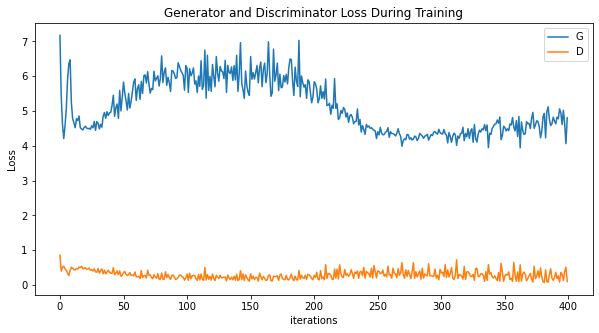

In [17]:
from statistics import mean

# reshape into one row per epoch, there are 137 batches per epoch
def chunks(l, n):
    n = max(1, n)
    return (l[i:i+n] for i in range(0, len(l), n))

epoch_G_losses = [mean(c) for c in chunks(G_losses, 137)]
epoch_D_losses = [mean(c) for c in chunks(D_losses, 137)]

plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(epoch_G_losses, label="G")
plt.plot(epoch_D_losses, label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 20976155 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


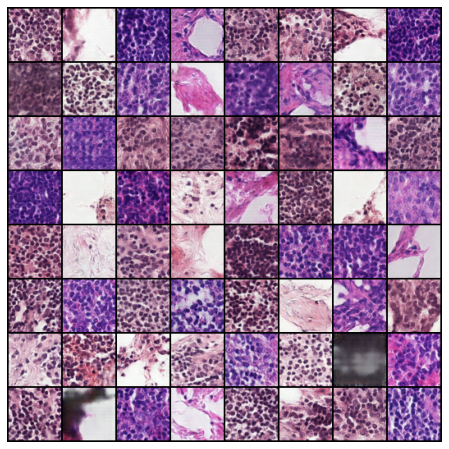

In [18]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
# load in a generator
def load_generator(path: Path) -> torch.nn.module:
    def save_model(name, model, epoch, optim, loss):
    filename = name + str(epoch) + '.pt'
    save_dir = experiment_root / 'gan_models'
    save_dir.mkdir(parents=True, exist_ok=True)
    save_path = save_dir / filename
    
    params_dict = {'epoch': epoch, 
                   'model_state_dict': model.state_dict(),
                   'optimizer_state_dict': optim.state_dict(),
                   'loss': loss
                  }
    
    torch.save(params_dict, save_path)

In [1]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

NameError: name 'dataloader' is not defined

In [ ]:
from math import ceil

from pathgen.utils.paths import project_root
from pathgen.utils.convert import np_to_pil

experiment_name = "paper"
experiment_root = project_root() / "experiments" / experiment_name

def generate_fake_batch(generator, batch_size):
    noise = torch.randn(batch_size, nz, 1, 1, device=device)
    batch = generator(noise)
    images = []
    for sample in batch:
        MEAN = torch.tensor([0.5, 0.5, 0.5], device=device)
        STD = torch.tensor([0.5, 0.5, 0.5], device=device)
        x = sample * STD[:, None, None] + MEAN[:, None, None]
        image = x.detach().cpu().numpy().transpose(1,2,0)
        images.append(image)
    return images

def save_fake_patches(generator, output_dir: Path, number_of_images: int):
    # make sure the output directory exists
    output_dir.mkdir(parents=True, exist_ok=True)
    batch_size = 64
    num_batches = int(ceil(number_of_images / batch_size))
    print(f"Exporting {num_batches} batches of fake images to {output_dir}", end=': ')
    for batch_idx in range(num_batches):
        print(f"{batch_idx}", end=', ')
        fake_batch = generate_fake_batch(netG, batch_size)
        for img_idx, np_image in enumerate(fake_batch):
            img = np_to_pil(np_image)
            img.save(output_dir / f"{batch_idx}-{img_idx}.png")
    print("Complete.")

gen = 
    
save_fake_patches(gen, experiment_root / "fake_patches" / "train" / "normal", 35000)
save_fake_patches(gen, experiment_root / "fake_patches" / "valid" / "normal", 15000)
save_fake_patches(gen, experiment_root / "fake_patches" / "test" / "normal", 15000)